In [1]:
# change the directory to EC523_Project_G
%cd ..
%pwd

d:\LocalLaptop\BU\courses\2024-Spring\EC523_CS523\Project01\EC523_Project_G


'd:\\LocalLaptop\\BU\\courses\\2024-Spring\\EC523_CS523\\Project01\\EC523_Project_G'

In [2]:
PHASE3_SCENE_DESCRIPTION_FILE = "./DATASET/PROCESSING_RECORD_PHASE3_SCENE_DESCRIPTION.json"

In [3]:
import json
from pathlib import Path
import shutil
from copy import deepcopy


with open(PHASE3_SCENE_DESCRIPTION_FILE, "r") as f:
    phase3_record = json.load(f)


In [4]:
scene_path_list = []
inpainting_image_path_list = []
fiugre_path_list = []
description_list = []

for series_name in phase3_record["dataset_dict"].keys():
    print(f"series_name: {series_name}")
    for ep_name in phase3_record["dataset_dict"][series_name].keys():
        print(f"\t ep_name: {ep_name}")
        ep = phase3_record["dataset_dict"][series_name][ep_name]
        for idx_scene, scene in enumerate(ep):
            # print(idx_scene)
            # print(scene.keys())
            print(f"\t\t scene idx: {idx_scene}")
            scene_data = scene["scene_data"]
            
            scene_path_list.append(scene_data["image_path_scene"])
            inpainting_image_path_list.append(scene_data["image_path_inpainting"])
            fiugre_path_list.append(scene_data["image_path_cropped_figures_with_bbox_segmt"])
            description_list.append(scene_data["image_scene_llava_description"])

            print(f"\t\t {scene_data['image_path_cropped_figures_with_bbox_segmt']}")

            print(f"\t\t scene_data: {scene_data.keys()}")
            print(f"\t\t image_scene_llama_description: {scene_data['image_scene_llava_description']}")
            print(f"\t\t image_path_inpainting: {scene_data['image_path_inpainting']}")
            print(f"\t\t image_path_scene: {scene_data['image_path_scene']}")
            print("\n")


series_name: usagi_s1_
	 ep_name: usagi_s1_01
		 scene idx: 0
		 [{'bbox': [181, 204, 75, 52], 'instance_id': 0, 'color': [16, 16, 255], 'img_path': 'DATASET/CROPPED_FIGURES/usagi_s1_/usagi_s1_01/scene_00000/figure_00000.png', 'mask_path': 'DATASET/CROPPED_FIGURES/usagi_s1_/usagi_s1_01/scene_00000/figure_00000_mask.png'}]
		 scene_data: dict_keys(['image_path_scene', 'image_path_segmt', 'image_path_cropped_figures_with_bbox_segmt', 'image_path_instance_removed', 'image_path_inpainting', 'subtitles_5_before', 'subtitles_5_after', 'image_scene_llava_description', 'video_time_in_seconds'])
		 image_scene_llama_description: [{'prompt': '<image>\nUSER: \ndescribe the figure and the scene\n\nASSISTANT:', 'description': '\nUSER: \ndescribe the figure and the scene\n\nASSISTANT: The image features a large, detailed drawing of a city street with a river running through it. The scene is set in a foreign country, and the street is lined with buildings, including a church. There are several people

In [5]:
# print(f"len(scene_path_list): {len(scene_path_list)}")
# print(f"len(image_path_list): {len(image_path_list)}")
# print(f"len(fiugre_path_list): {len(fiugre_path_list)}")
# print(f"len(description_list): {len(description_list)}")

# print(fiugre_path_list)
import numpy as np
figure_count = []
for x in fiugre_path_list:
    # print(len(x))
    figure_count.append(len(x))
unique, counts = np.unique(figure_count, return_counts=True)
for u, c in zip(unique, counts):
    print(f"u: {u}, c: {c}")
    if u > 2:
        break

print(scene_path_list[0])
i = 0
print(len(inpainting_image_path_list[0]), inpainting_image_path_list[0][i]["path"])
print(len(fiugre_path_list[0]), fiugre_path_list[0][i]["img_path"])
# prefix_len = len(description_list[0][i]["prompt"])
# print(prefix_len)
# print(len(description_list[0]), description_list[0][i]["description"])

print("\n\n\n", description_list[0][i]["description"].split("ASSISTANT:")[1])

# print("\n\n\n", description_list[0][i]["prompt"])

u: 1, c: 3694
u: 2, c: 2404
u: 3, c: 1291
DATASET/SCENE/usagi_s1_/usagi_s1_01/scene_00000.png
6 DATASET/INPAINTING_IMAGE/usagi_s1_/usagi_s1_01/scene_00000/inpainting_00000.png
1 DATASET/CROPPED_FIGURES/usagi_s1_/usagi_s1_01/scene_00000/figure_00000.png



  The image features a large, detailed drawing of a city street with a river running through it. The scene is set in a foreign country, and the street is lined with buildings, including a church. There are several people walking along the street, and a few umbrellas can be seen, possibly indicating a rainy day. The overall atmosphere of the drawing is lively and bustling, capturing the essence of a busy urban environment.


In [6]:
import torch
import torch.nn.functional as F


def random_pad_to_size(image, size=(256,256), transform=None):
    target_height, target_width = size
    
    image = torch.tensor(image)
    if transform is not None:
        image = transform(image)
    # Getting the original size
    C, H, W = image.shape
    ratio = max(H / size[0], W / size[1])
    if ratio > 1:
        print("ratio: ", ratio)
        image = F.interpolate(image[None], size=(int(H/ratio), int(W/ratio)), mode='bilinear', align_corners=False)[0]
    # print(image.shape)
    C, H, W = image.shape

    # Calculating the padding needed
    padding_height = max(target_height - H, 0)
    padding_width = max(target_width - W, 0)

    # Distributing the padding on both sides randomly
    top_pad = torch.randint(0, padding_height + 1, (1,)).item()
    bottom_pad = padding_height - top_pad

    left_pad = torch.randint(0, padding_width + 1, (1,)).item()
    right_pad = padding_width - left_pad

    # Applying the padding
    # Pad format is (left, right, top, bottom)
    padded_image = F.pad(image, (left_pad, right_pad, top_pad, bottom_pad), 'constant', 0)

    # Verify the size
    assert padded_image.size(1) == 256 and padded_image.size(2) == 256, "Image was not properly padded."

    padded_image = padded_image.numpy()
    return padded_image



# C, H, W = 3, 300, 150  # Example dimensions
# image = torch.rand(C, H, W)  # Random image

# padded_image = random_pad_to_size(image, size=(256, 256))

# print(f"Original size: {H}x{W}, New size: {padded_image.size(1)}x{padded_image.size(2)}")


In [7]:

from torch.utils.data import Dataset, DataLoader
import torch
import PIL
from PIL import Image
from pathlib import Path
import torchvision

class FigureSceneDataset(Dataset):
    def __init__(self, scene_path_list, inpainting_image_path_list, fiugre_path_list, description_list, MAX_NUM_FIGURE=5, dataset_path="./", figure_transform_flag = False):
        self.scene_path_list = scene_path_list
        self.inpainting_image_path_list = inpainting_image_path_list
        self.figure_path_list = fiugre_path_list
        self.MAX_NUM_FIGURE = MAX_NUM_FIGURE
        self.description_list = description_list

        self.dataset_path = dataset_path
        self.figure_transform_flag = figure_transform_flag

    def __len__(self):
        return len(self.scene_path_list)

    def __getitem__(self, idx):
        print(idx)
        scene_path = self.scene_path_list[idx]
        inpainting_image_path_list = self.inpainting_image_path_list[idx]
        figure_path = self.figure_path_list[idx]
        descriptions = self.description_list[idx]

        scene_img = Image.open(Path(self.dataset_path) / scene_path)
        scene_img = scene_img.convert("RGB")
        scene_img = scene_img.resize((256, 256))
        scene_img = np.array(scene_img) / 255.0

        len_inpainting_image = len(inpainting_image_path_list)
        i = np.random.randint(0, len_inpainting_image)
        inpainting_image_path = inpainting_image_path_list[i]["path"]
        inpainting_img = Image.open(Path(self.dataset_path) / inpainting_image_path)
        inpainting_img = inpainting_img.convert("RGB")
        inpainting_img = inpainting_img.resize((256,256))
        inpainting_img = np.array(inpainting_img) / 255.0

        # figure_img_list = []
        figure_img_list = np.zeros((self.MAX_NUM_FIGURE, 3, 256, 256))
        len_figure = min(len(figure_path), self.MAX_NUM_FIGURE)
        for i_figure, path in enumerate(figure_path):
            figure_img_path = path["img_path"].replace("mask_", "")
            figure_img = Image.open(Path(self.dataset_path) / figure_img_path)
            figure_img = figure_img.convert("RGB")
            figure_img = np.array(figure_img).transpose(2, 0, 1)


            if self.figure_transform_flag == True:
                figure_transform = torchvision.transforms.Compose([
                    torchvision.transforms.RandomAffine(degrees=15, translate=(0.1, 0.1), scale=(0.9, 1.1), shear=0, interpolation=torchvision.transforms.InterpolationMode.BILINEAR, fill=0),
                    # torch.transforms.Resize((256, 256)),
                    torchvision.transforms.RandomHorizontalFlip(),
                    # torch.transforms.ToTensor(),
                    # torch.transforms.Normalize(mean=[0.485, 0.456, 0.406],
                    #                            std=[0.229, 0.224, 0.225])
                ])
            else:
                figure_transform = None

            figure_img = random_pad_to_size(figure_img, size=(256, 256), transform=figure_transform)
            figure_img_list[i_figure] = figure_img / 255.0
            if (i_figure+1) == len_figure:
                break
            # plt.imshow(figure_img_list[i_figure].transpose(1, 2, 0))
            # print(figure_img.shape)

        # len_figure = len(fiugre_path)
        # i = np.random.randint(0, len_figure)
        # figure_img = PIL.Image.open(Path(self.dataset_path) / figure_path[i]["img_path"])

        len_descriptions = len(descriptions)
        i = np.random.randint(0, len_descriptions)
        description = descriptions[i]["description"].split("ASSISTANT:")[1]

        # return self.scene_path_list[idx], self.image_path_list[idx], self.fiugre_path_list[idx], self.description_list[idx]
        return scene_img, inpainting_img, figure_img_list, description, len_figure

### Batch size = 1

In [8]:
figure_scene_dataset = FigureSceneDataset(scene_path_list, inpainting_image_path_list, fiugre_path_list, description_list, dataset_path="./", MAX_NUM_FIGURE=5)
figure_scene_dataloader_B1 = DataLoader(figure_scene_dataset, batch_size=1, shuffle=False)

In [9]:
figure_scene_dataloader_B1_iter = iter(figure_scene_dataloader_B1)

In [18]:
data = next(figure_scene_dataloader_B1_iter)


1
[tensor([[[[0.8980, 0.8824, 0.8588],
          [0.8784, 0.8706, 0.8627],
          [0.7490, 0.7529, 0.7725],
          ...,
          [0.9686, 0.9725, 0.9843],
          [0.9647, 0.9686, 0.9804],
          [0.9804, 0.9843, 0.9882]],

         [[0.9098, 0.8902, 0.8667],
          [0.8745, 0.8667, 0.8588],
          [0.7490, 0.7529, 0.7725],
          ...,
          [0.9686, 0.9725, 0.9843],
          [0.9608, 0.9647, 0.9765],
          [0.9765, 0.9804, 0.9922]],

         [[0.9059, 0.8902, 0.8667],
          [0.8039, 0.7961, 0.7882],
          [0.7373, 0.7412, 0.7608],
          ...,
          [0.9686, 0.9725, 0.9843],
          [0.9647, 0.9686, 0.9804],
          [0.9725, 0.9765, 0.9882]],

         ...,

         [[0.2706, 0.2588, 0.2000],
          [0.2706, 0.2588, 0.2078],
          [0.2667, 0.2431, 0.2157],
          ...,
          [0.7608, 0.7176, 0.6588],
          [0.7412, 0.7020, 0.6549],
          [0.7294, 0.7098, 0.6549]],

         [[0.2667, 0.2588, 0.1882],
          [0.2

tensor([1, 3, 3, 1])
 In the image, there are several people walking along a narrow alleyway between two buildings. The alleyway is surrounded by buildings on both sides, creating a sense of confinement. The people are walking in the middle of the alley, which is a relatively narrow space. The relationship between the figures and their surrounding is that they are navigating through the limited space available, which is a common occurrence in urban environments with narrow streets and alleyways. The people are likely going about their daily activities, such as commuting or running errands, while the buildings on either side of the alleyway provide a backdrop


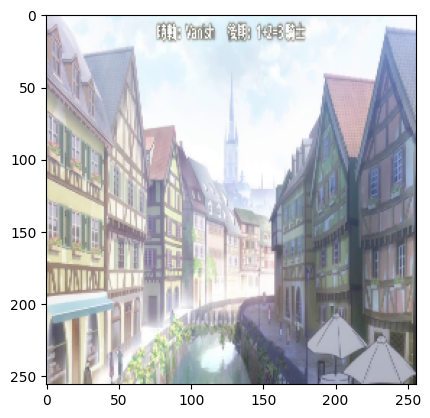

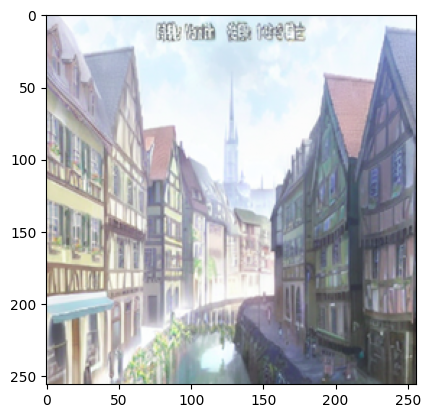

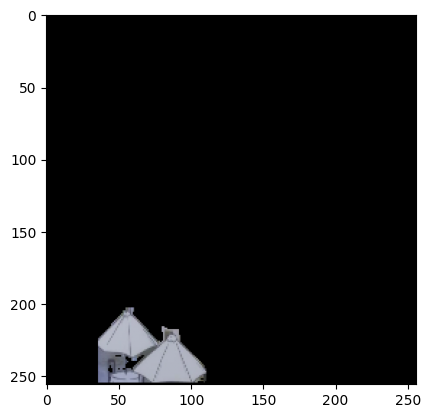

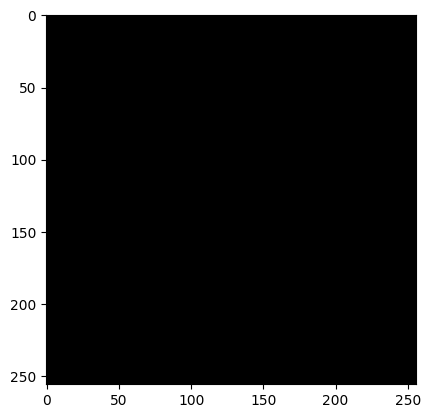

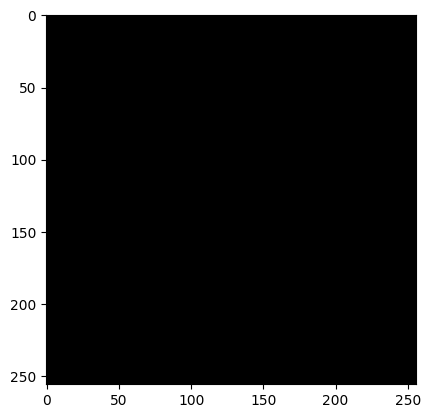

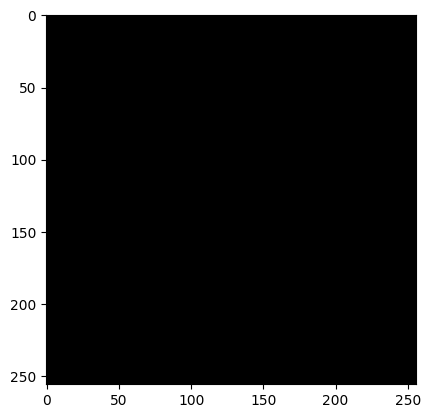

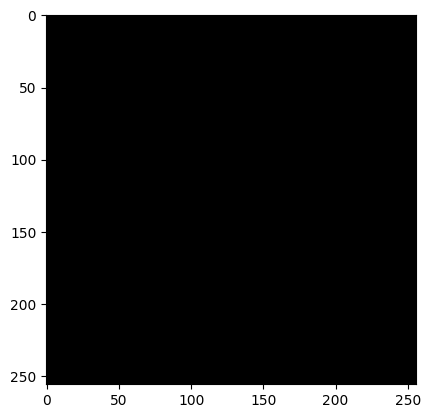

In [17]:
from matplotlib import pyplot as plt

scene_img, inpainting_img, figure_img_list, description, num_figure = data

# print(scene_img.shape)
plt.figure()
plt.imshow(scene_img[0])

plt.figure()
plt.imshow(inpainting_img[0])

print(num_figure)

len_figure = len(figure_img_list[0])
for i in range(len_figure):
    plt.figure()
    plt.imshow(figure_img_list[0][i].permute(1,2,0))
# print(figure_img_list.shape)
# print(figure_img_list[0][0].shape)
# # print(figure_img_list[0][0].shape)
# # plt.figure()
# # plt.imshow(figure_img_list[0][0].permute(1,2,0))

print(description[0])

### Batch Size = 4

In [12]:
figure_scene_dataset = FigureSceneDataset(scene_path_list, inpainting_image_path_list, fiugre_path_list, description_list, dataset_path="./")
figure_scene_dataloader = DataLoader(figure_scene_dataset, batch_size=4, shuffle=False)

In [13]:
figure_scene_dataloader_iter = iter(figure_scene_dataloader)

In [14]:
data = next(figure_scene_dataloader_iter)
scene_img, inpainting_img, figure_img_list, description, num_figure = data

print(scene_img.shape)
print(inpainting_img.shape)
print(figure_img_list.shape)
print(description)
print(num_figure)

# print(type(figure_img_list))

0
1
2
3
torch.Size([4, 256, 256, 3])
torch.Size([4, 256, 256, 3])
torch.Size([4, 5, 3, 256, 256])
(' In the image, there are several people walking along a narrow alleyway between two buildings. The alleyway is surrounded by buildings on both sides, creating a sense of confinement. The people are walking in the middle of the alley, which is a relatively narrow space. The relationship between the figures and their surrounding is that they are navigating through the limited space available, which is a common occurrence in urban environments with narrow streets and alleyways. The people are likely going about their daily activities, such as commuting or running errands, while the buildings on either side of the alleyway provide a backdrop', ' The image depicts a lively outdoor scene with several people sitting at tables, enjoying their time together. There are at least five people visible in the scene, with some sitting at tables and others standing nearby. The tables are adorned with umb